# Something in Fourier Domain
## Localized Fourier Transform
NOTE: it took 5h too compute for one image with kernel size 32 so seems unfeasible
Also I'm not sure what I gain compared to a direct manipulation in the fourier domain

Determine a frequency spectrum for each image point localized around that point. (How to window? Same as in audio I guess to reduce artifacts).
Result at that point is computed eg by integrating the product of the spectrum and a fourier domain filter function.
## Side-Notes
Seems like a more general idea to the vairance thing as we adress different frequencies of spatial variace differently not just the mean

In [1]:
# First we start with a simple 2d fourier transform of the image

import sys; sys.path += [".."]  # NOTE find shared modules

from util.preprocess import *
from util.plot import *

import cv2
import skimage
import colour   # from colour-science
from scipy.fft import fft2, fftshift

from skimage.filters import window
from scipy.ndimage import generic_filter

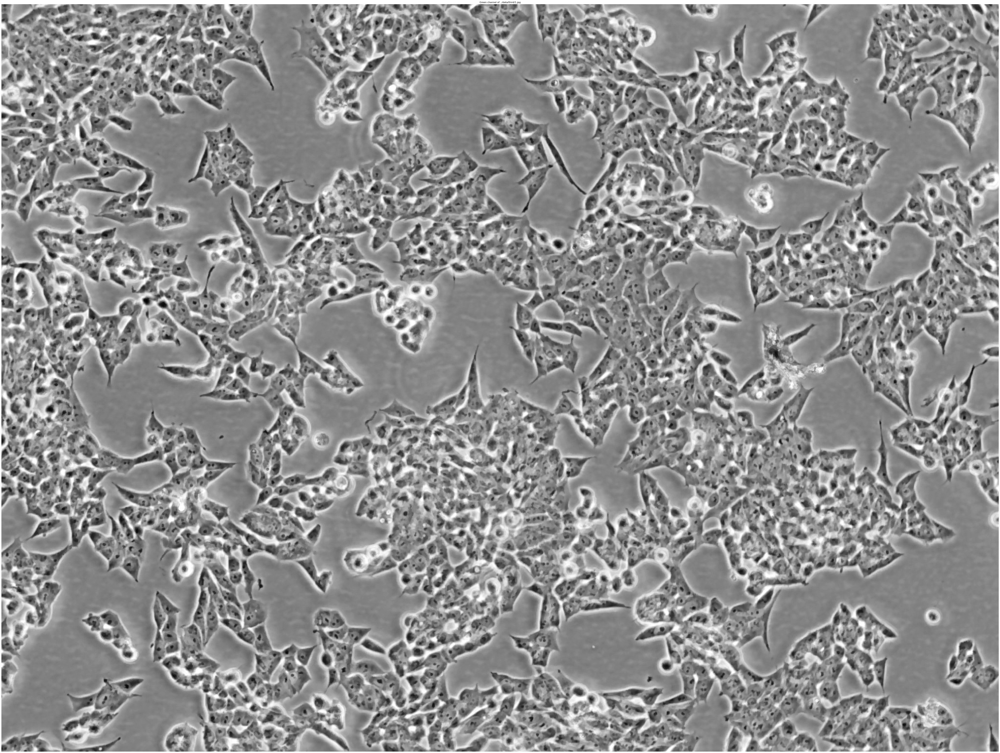

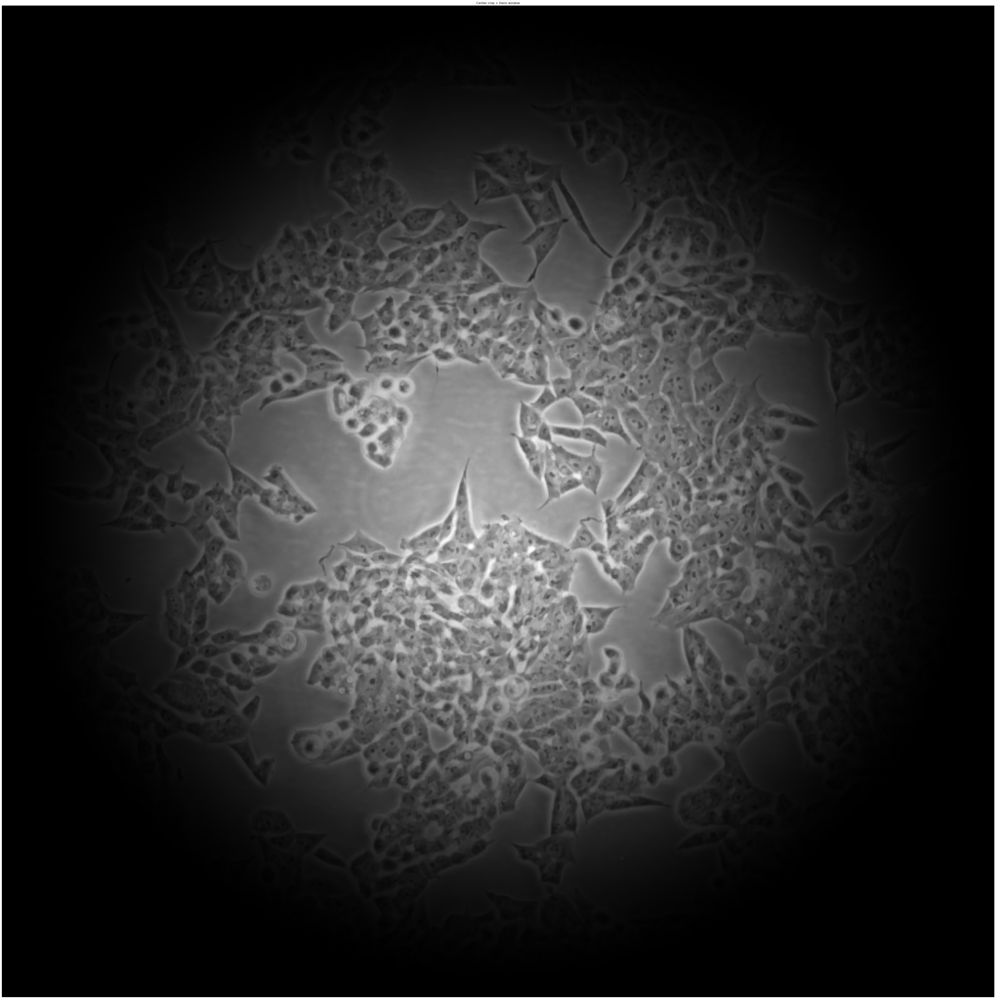

In [2]:

img = "../data/third/1.jpg"

RGB = skimage.io.imread(img).astype(float) / 255
G = RGB[:,:,1]  # we select the green channel because atleast in third/1.jpg this seems to be the most in focus

imshow(G, title=f"Green channel of {img}");


# crop a center sqare of the image
H,W = G.shape
G_window = G[:, (_d := (W-H) // 2):W-_d] * window('hann', (H,H))
imshow(G_window, title=f"Center crop + Hann window");

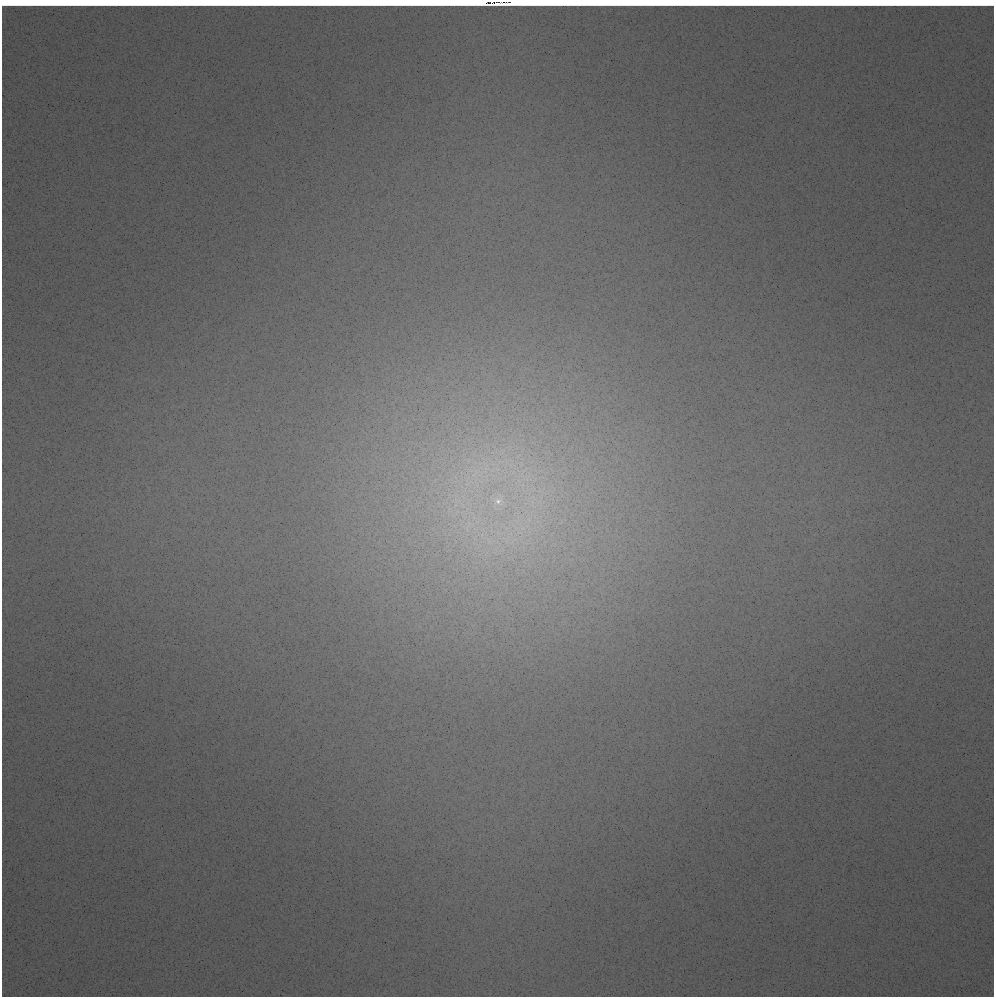

In [3]:
F = fftshift(fft2(G_window))
F = np.log(np.abs(F)) 

imshow(F, title=f"Fourier transform");

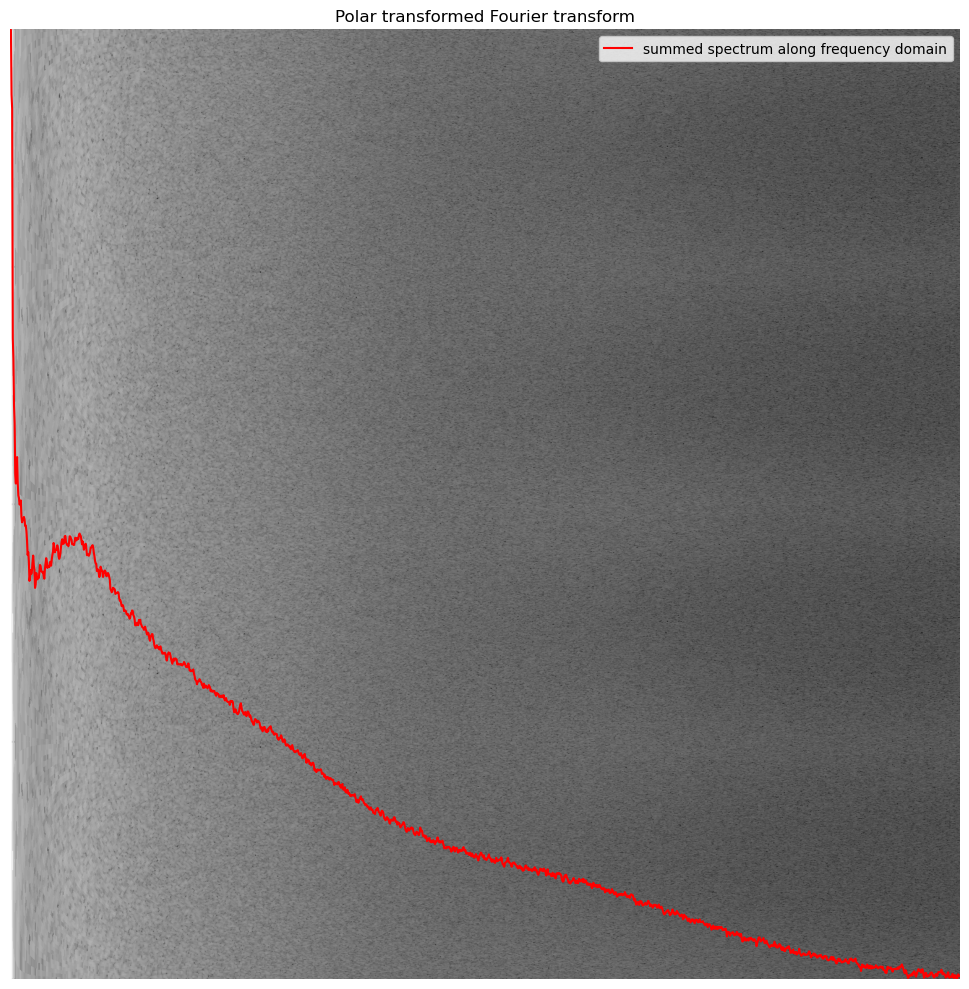

In [4]:
# convert the 2D FFT to an 1D FFT by assuming isometry between the x and y axis and + and - frequencies
P = cv2.linearPolar(F,(H/2, H/2), H/2, cv2.WARP_FILL_OUTLIERS)

# sum along vertical to ignore wave angle
f = P.sum(axis=0)
# normalize
f = (f - f.min()) / (f.max() - f.min())

# interpolate the spectrum to have 780-380=400 / 20 values
SPEC_N = (780-380) // 5
spec_ = np.interp(np.linspace(0, len(f), SPEC_N), np.arange(len(f)), f)

# interpret the spectrum as a color spectrum between 380nm and 780nm
spectral_distribution = colour.SpectralDistribution(spec_, domain=np.linspace(380, 780-400/SPEC_N, SPEC_N))
color = colour.convert(spectral_distribution, "Spectral Distribution", "sRGB")

fig, ax = plt.subplots(1,1, figsize=(10,10))
ax.plot(H-f*H, label="summed spectrum along frequency domain", c='red')
imshow(P, ax=ax, title="Polar transformed Fourier transform")
ax.legend();

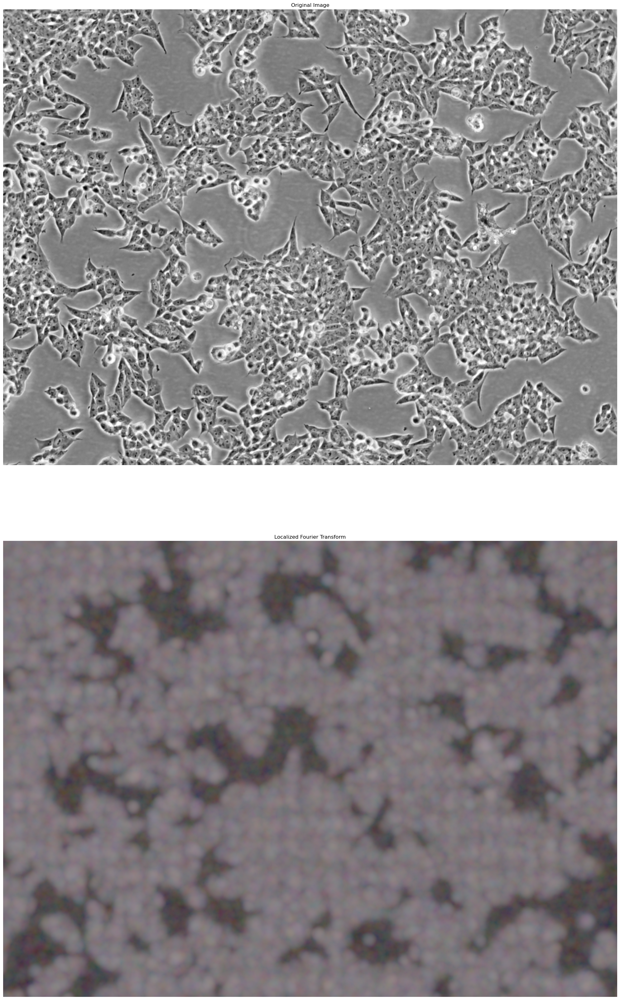

In [5]:

def mk_kernel(size):
  W = window('hann', (size,size))
  s2 = size//2

  def kernel(x_flat):
    # reshape to square
    # apply hann window
    x = x_flat.reshape(size,size) * W
    # apply fourier transform
    x = np.log(np.abs(fftshift(fft2(x))))
    # polar transform
    x = cv2.linearPolar(x,(s2,s2), s2, cv2.WARP_FILL_OUTLIERS)
    # sum along vertical to ignore wave angle
    x = x.sum(axis=0)

    return x
  
  return kernel


s = 64
s_ = 1
I = G

# sadly cant use scipy.ndimage.generic_filter because it only supports scalar results https://github.com/scipy/scipy/issues/5137
# also its slow https://notmatthancock.github.io/2020/04/19/scipy-generic-filter-low-level-callable.html
# LFT = generic_filter(G[:512,:512], mk_kernel(s), size=s)

LFT = np.zeros((*I.shape, s//s_))
kern = mk_kernel(s)

# TODO: aaa so slow
# TODO padding (mirrot)
for y in range(s//2, I.shape[0]-s//2):
  for x in range(s//2, I.shape[1]-s//2):
    LFT[y,x] = kern(I[y-s//2:y+s//2, x-s//2:x+s//2])[::s_]

# normalize (globally!)
LFT = (LFT - LFT.min()) / (LFT.max() - LFT.min())

np.save("../runs/1-lft.npy", LFT)

wavels = np.linspace(780-20*(s//s_-1), 780, s//s_, dtype=int)

f = lambda x: colour.convert(colour.SpectralDistribution(x, domain=wavels), "Spectral Distribution", "sRGB")

# now apply f along the last axis 
out = np.apply_along_axis(f, -1, LFT)


# plot LFT and G next to each otther
fig, (a,b) = plt.subplots(2,1, figsize=(20,40))
imshow(I[s//2:-s//2, s//2:-s//2], ax=a, title="Original Image")
imshow(out[s//2:-s//2, s//2:-s//2], ax=b, title="Localized Fourier Transform");